In [1]:
import os
import cv2
import numpy as np
import albumentations as A
from matplotlib import pyplot as plt

In [2]:
df = '/kaggle/input/fruits/fruits-360-original-size/fruits-360-original-size/Training'

In [3]:
img_width, img_height = 224, 224

In [5]:
transforms = [
    A.HorizontalFlip(p=1.0),
    A.VerticalFlip(p=1.0),
    A.Rotate(limit=30, p=1.0),
    A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=1.0),
    A.RandomGamma(gamma_limit=(80, 120), p=1.0),
    A.GaussNoise(var_limit=(10.0, 50.0), p=1.0),
    A.ISONoise(color_shift=(0.01, 0.05), intensity=(0.1, 0.5), p=1.0),
    A.MotionBlur(blur_limit=7, p=1.0),
    A.MedianBlur(blur_limit=7, p=1.0),
    A.Blur(blur_limit=7, p=1.0),
    A.CLAHE(clip_limit=4.0, tile_grid_size=(8, 8), p=1.0),
    A.RandomCrop(height=200, width=200, p=1.0),
    A.RandomResizedCrop(height=224, width=224, scale=(0.8, 1.0), ratio=(0.75, 1.33), p=1.0),
    A.Compose([
        A.Resize(height=256, width=256),
        A.RandomCrop(height=224, width=224)
    ])
]

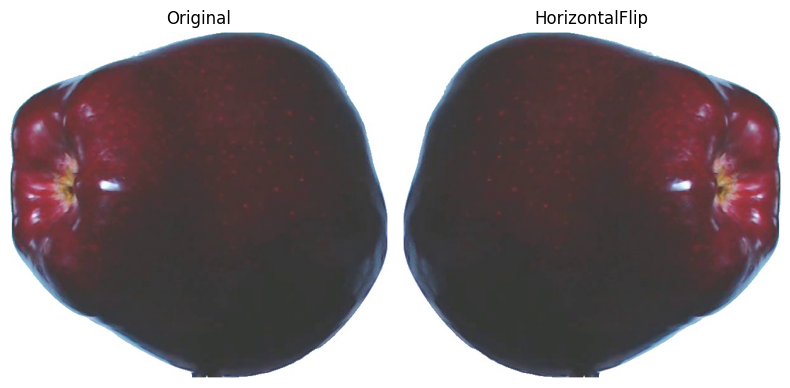

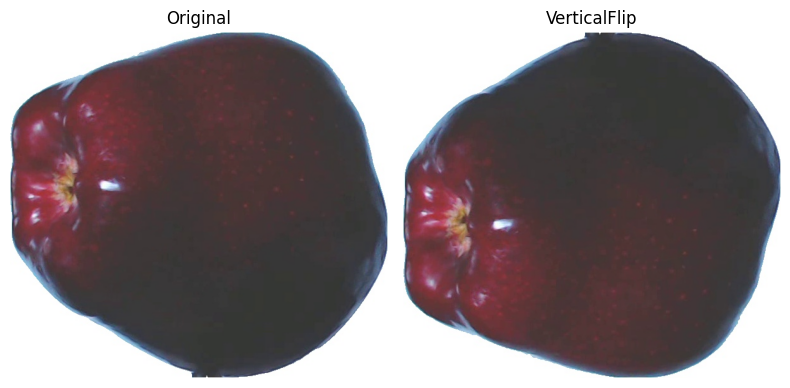

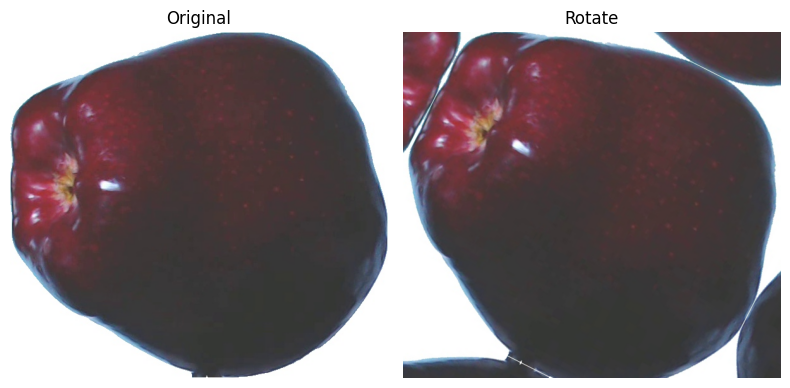

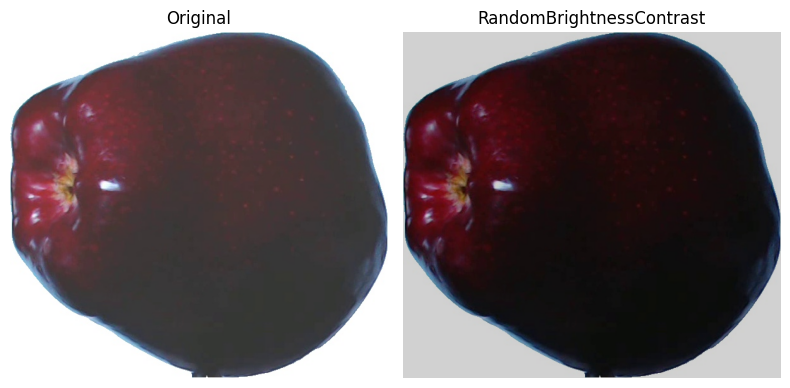

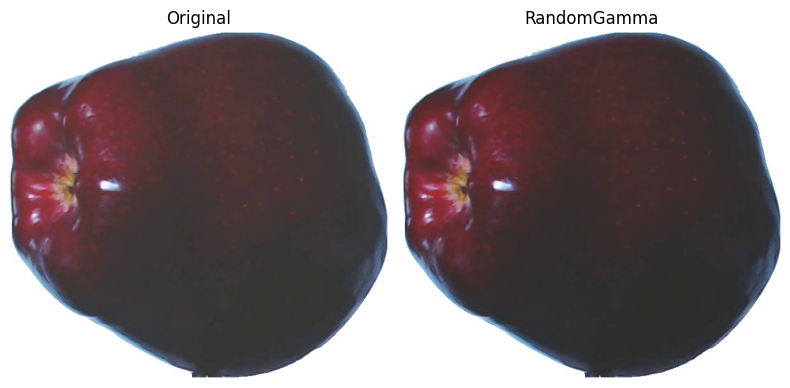

...

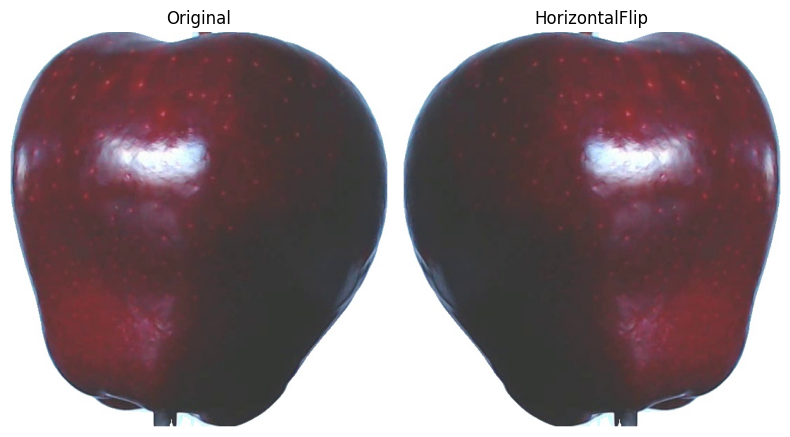

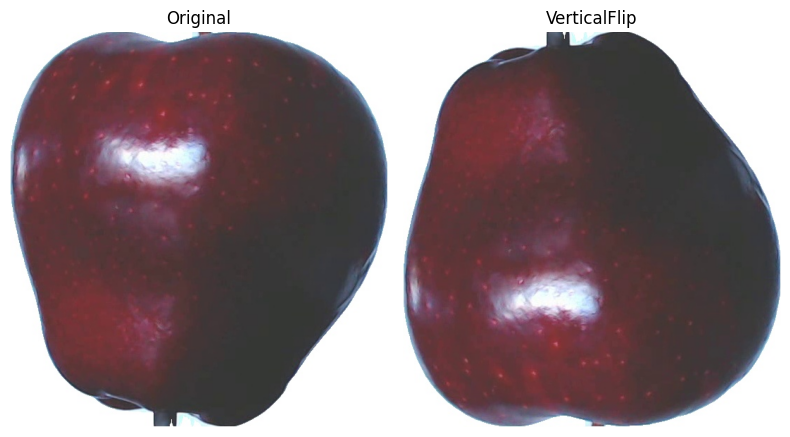

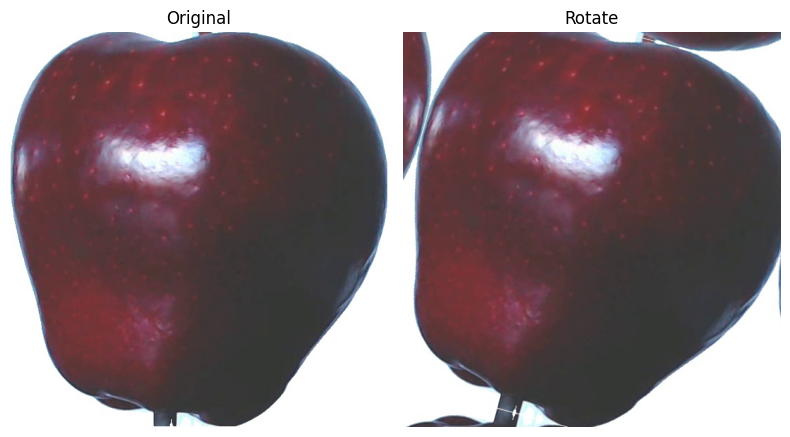

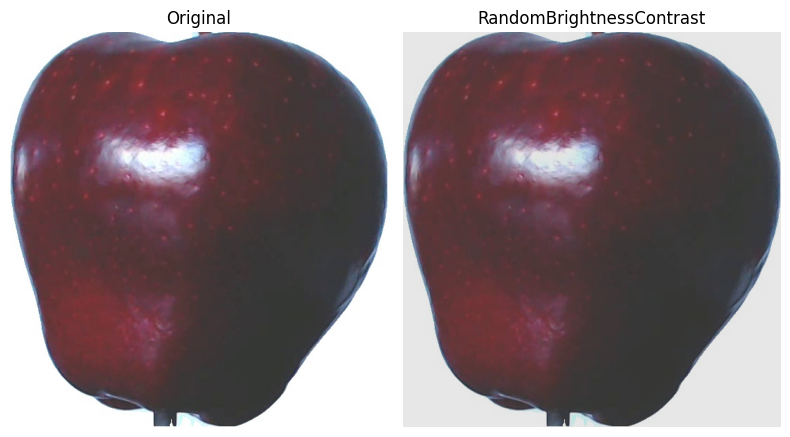

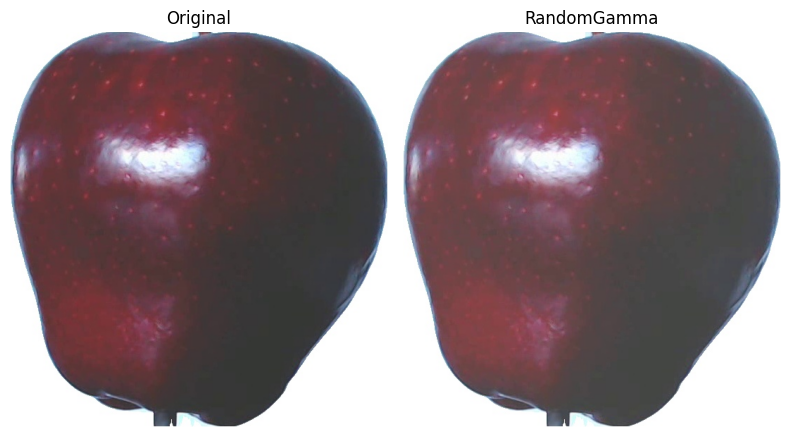

In [ ]:
for subfolder in os.listdir(df):
    subfolder_path = os.path.join(df, subfolder)
    
    for image_file in os.listdir(subfolder_path):
        image_path = os.path.join(subfolder_path, image_file)
        
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        for transform in transforms:
            transformed_image = transform(image=image)['image']
            
            plt.figure(figsize=(8, 8))
            plt.subplot(1, 2, 1)
            plt.imshow(image)
            plt.title('Original')
            plt.axis('off')
            plt.subplot(1, 2, 2)
            plt.imshow(transformed_image)
            plt.title(type(transform).__name__)
            plt.axis('off')
            plt.tight_layout()
            plt.show()